In [1]:
#import import_ipynb
#import Scanpy_functions_v03262021 as sc_pipe
import scvelo as scv
scv.logging.print_version()
import warnings
#import scirpy as ir
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
import slepc4py

Running scvelo 0.2.5 (python 3.8.13) on 2023-02-21 10:45.


ERROR: XMLRPC request failed [code: -32500]
RuntimeError: PyPI no longer supports 'pip search' (or XML-RPC search). Please use https://pypi.org/search (via a browser) instead. See https://warehouse.pypa.io/api-reference/xml-rpc.html#deprecated-methods for more information.


In [2]:

In_path = '/user/ifrec/liuyuchen/scRNASeq_DATA/Akira_Fukusima_scRNASeq/'

out_path = '/user/ifrec/liuyuchen/Analysis_Reports/Akira_Fukusima_scRNASeq/human/'

In [3]:
#sc.set_figure_params(scanpy=True, dpi=200,  figsize=[12.8,9.6])
scv.settings.verbosity = 3  # show errors(0), warnings(1), info(2), hints(3)
scv.settings.presenter_view = True  # set max width size for presenter view
scv.set_figure_params('scvelo')  # for beautified visualization


In [4]:
adata =sc.read_h5ad(out_path+'/human_subset_remove_PBMC_DC.h5ad')

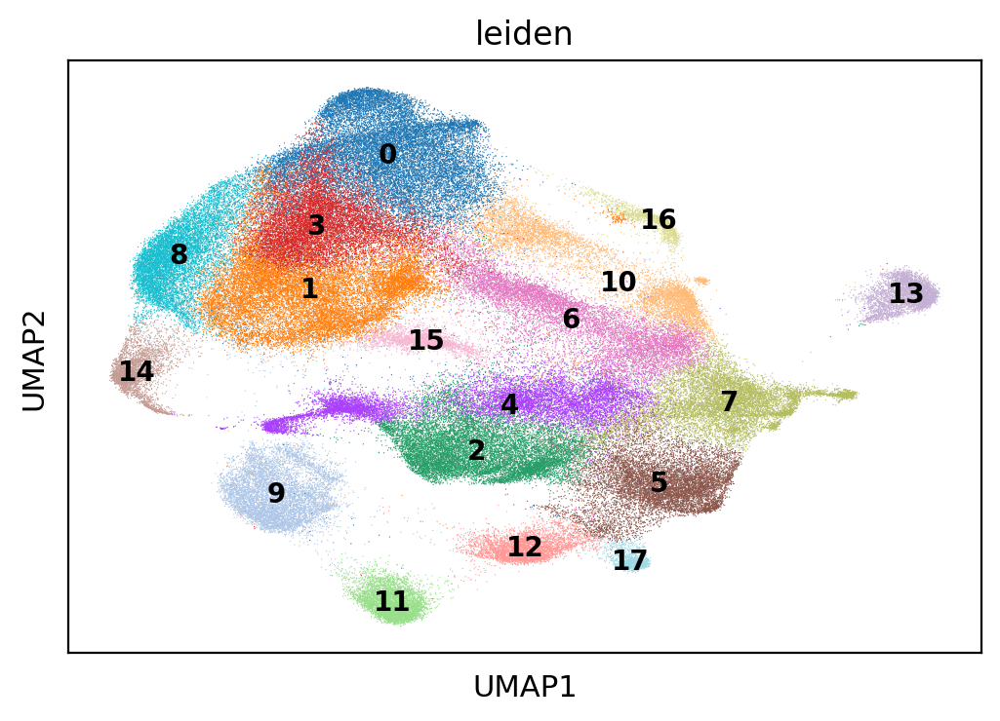

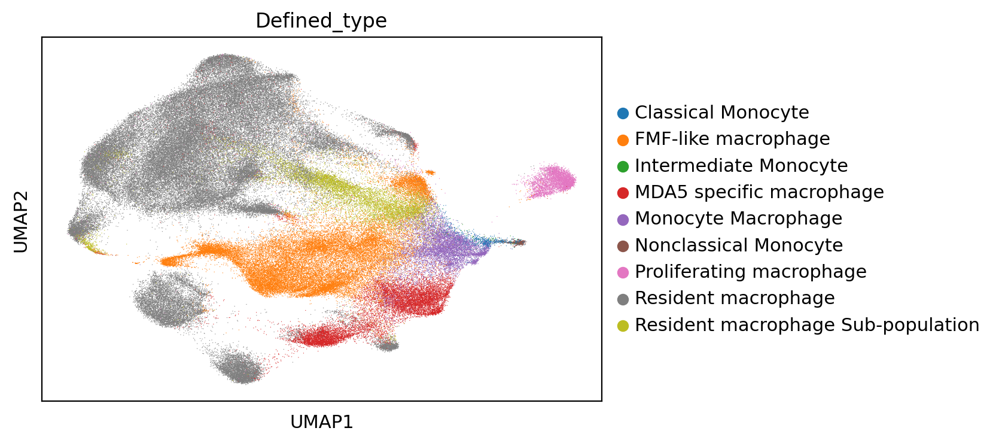

In [5]:
sc.pl.umap(adata, color='leiden', legend_loc='on data',legend_fontsize=10) 
sc.pl.umap(adata, color = 'Defined_type')

In [6]:
adata.obs['Defined_type']=adata.obs['Defined_type'].astype(str)
adata.obs.loc[adata.obs['Defined_type']=='FMC macrophage','Defined_type']='FMF-like macrophage'

In [7]:
adata.obs.loc[adata.obs['leiden']=='2','Defined_type']='FMF-like macrophage'
adata.obs.loc[adata.obs['leiden']=='4','Defined_type']='FMF-like macrophage'

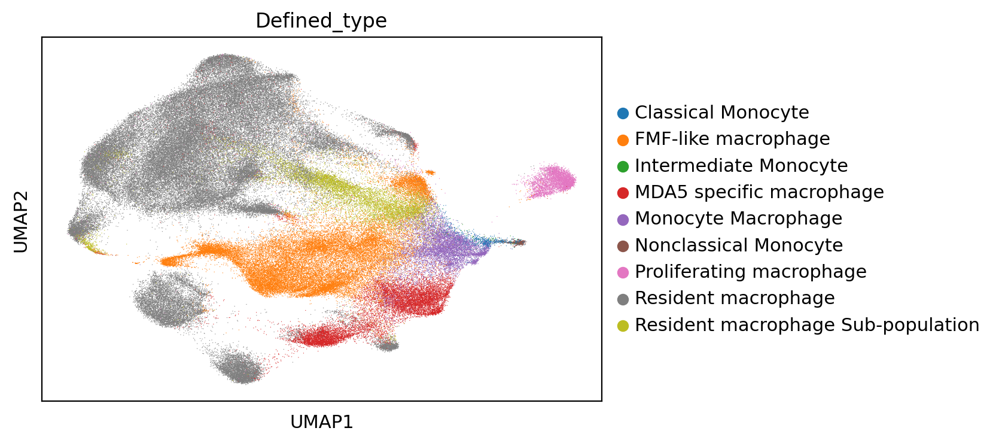

In [8]:
sc.pl.umap(adata, color = 'Defined_type')

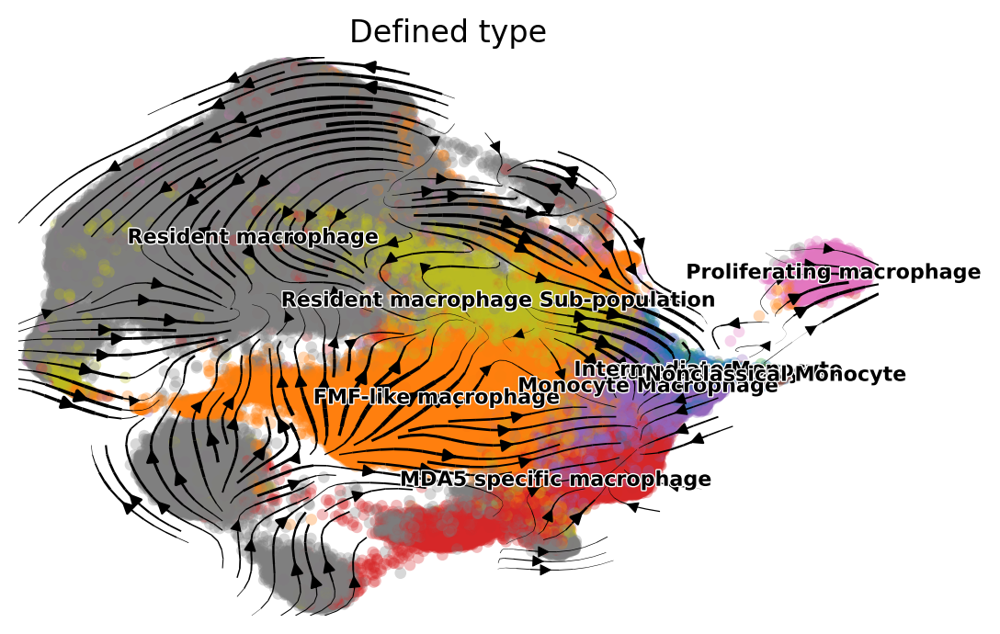

In [9]:

scv.pl.velocity_embedding_stream(
   adata, basis="umap", legend_fontsize=8, color ='Defined_type',smooth=0.8, min_mass=2
)


In [10]:
for c in adata.obs.select_dtypes(include=['category']).columns:
     adata.obs[c]=adata.obs[c].astype(str)

In [11]:
adata.write(out_path+'/human_subset_remove_PBMC_DC.h5ad')

In [13]:
import cellrank as cr
scv.settings.verbosity = 3
scv.settings.set_figure_params("scvelo")
cr.settings.verbosity = 2
import warnings

warnings.simplefilter("ignore", category=UserWarning)
warnings.simplefilter("ignore", category=FutureWarning)
warnings.simplefilter("ignore", category=DeprecationWarning)

In [14]:
cr.tl.terminal_states(adata, cluster_key='Defined_type', weight_connectivities=0.2,n_jobs=4,n_states=6)


Accessing `adata.obsp['T_fwd']`


/var/tmp/pbs.54523.idnfront2/ipykernel_1490179/3928873906.py:1: DeprecationWarning: `cellrank.tl.terminal_states` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.terminal_states(adata, cluster_key='Defined_type', weight_connectivities=0.2,n_jobs=4,n_states=6)
/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/cellrank/tl/_init_term_states.py:156: DeprecationWarning: `cellrank.tl.transition_matrix` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  kernel = transition_matrix(


Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode


100%|███████████████████████████████| 153706/153706 [01:21<00:00, 1896.20cell/s]


Setting `softmax_scale=5.0790`


100%|███████████████████████████████| 153706/153706 [01:09<00:00, 2200.01cell/s]


    Finish (0:03:23)
Using a connectivity kernel with weight `0.2`
Computing transition matrix based on `adata.obsp['connectivities']`
    Finish (0:00:03)
Computing Schur decomposition
Adding `adata.uns['eigendecomposition_fwd']`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:38)
Computing `6` macrostates
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:53)
Adding `adata.obs['terminal_states']`
       `adata.obs['terminal_states_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


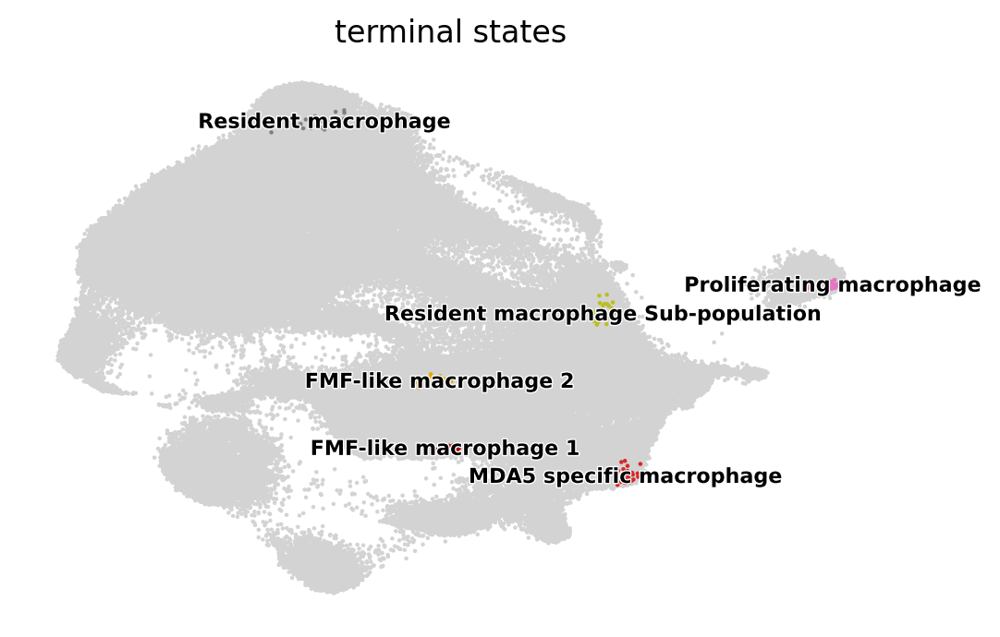

In [15]:
cr.pl.terminal_states(adata, discrete=True,legend_fontsize=8)

Accessing `adata.obsp['T_bwd']`


/var/tmp/pbs.54523.idnfront2/ipykernel_1490179/1505559493.py:1: DeprecationWarning: `cellrank.tl.initial_states` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.initial_states(adata, cluster_key='Defined_type',n_jobs=4,n_states=1)
/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/cellrank/tl/_init_term_states.py:156: DeprecationWarning: `cellrank.tl.transition_matrix` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  kernel = transition_matrix(


Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode


100%|███████████████████████████████| 153706/153706 [01:56<00:00, 1317.97cell/s]


Setting `softmax_scale=5.0790`


100%|███████████████████████████████| 153706/153706 [01:54<00:00, 1337.89cell/s]
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 13 Broken Pipe: Likely while reading or writing to a socket
[0]PETSC ERROR: ------------------------------------------------------------------------
[0]PETSC ERROR: Caught signal number 11 SEGV: Segmentation Violation, probably memory access out of range
[0]PETSC ERROR: Try option -start_in_debugger or -on_error_attach_debugger
[0]PETSC ERROR: or see https://petsc.org/release/faq/#valgrind and https://petsc.org/release/faq/
[0]PETSC ERROR: configure using --with-debugging=yes, recompile, link, and run 
[0]PETSC ERROR: to get more information on the crash.
[0]PETSC ERROR: Run with -malloc_debug to check if memory corruption is causing the crash.


    Finish (0:04:47)
Using a connectivity kernel with weight `0.2`
Computing transition matrix based on `adata.obsp['connectivities']`
    Finish (0:00:03)
Computing eigendecomposition of the transition matrix
Adding `adata.uns['eigendecomposition_bwd']`
       `.eigendecomposition`
    Finish (0:01:58)
For 1 macrostate, stationary distribution is computed
Adding `.macrostates`
       `.macrostates_memberships`
       `.coarse_T`
       `.coarse_initial_distribution
       `.coarse_stationary_distribution`
       `.schur_vectors`
       `.schur_matrix`
       `.eigendecomposition`
    Finish (0:00:00)
Adding `adata.obs['initial_states']`
       `adata.obs['initial_states_probs']`
       `.terminal_states`
       `.terminal_states_probabilities`
       `.terminal_states_memberships
    Finish`


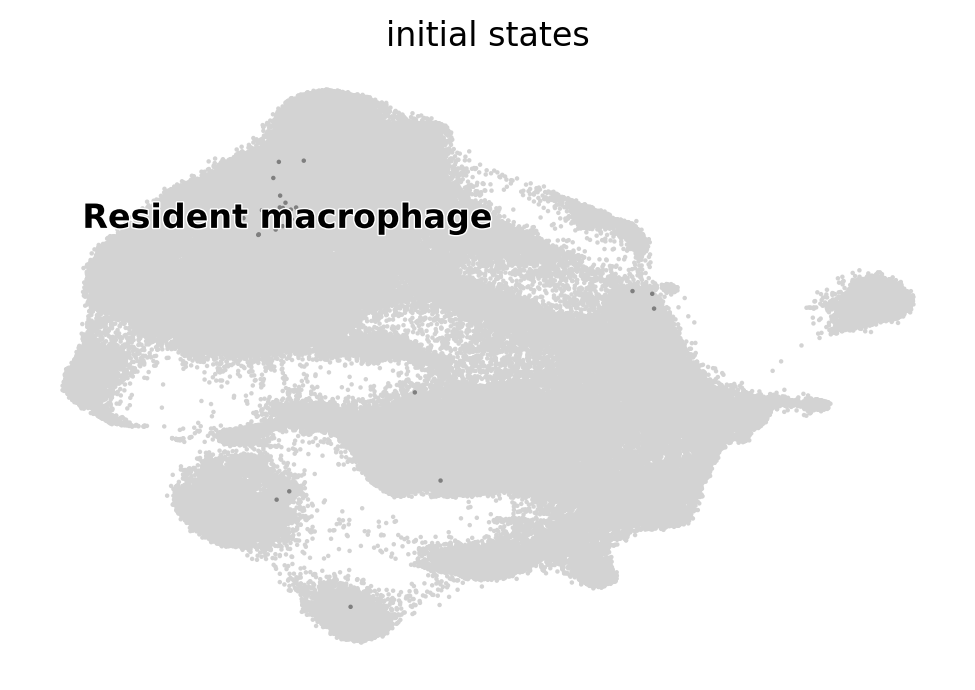

In [16]:
cr.tl.initial_states(adata, cluster_key='Defined_type',n_jobs=4,n_states=1)
cr.pl.initial_states(adata, discrete=True)

/var/tmp/pbs.54523.idnfront2/ipykernel_1490179/3086418465.py:1: DeprecationWarning: `cellrank.tl.lineages` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.lineages(adata)


Computing absorption probabilities


100%|███████████████████████████████████████████████| 6/6 [00:48<00:00,  8.07s/]


Adding `adata.obsm['to_terminal_states']`
       `.absorption_probabilities`
    Finish (0:00:50)


/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDepreca

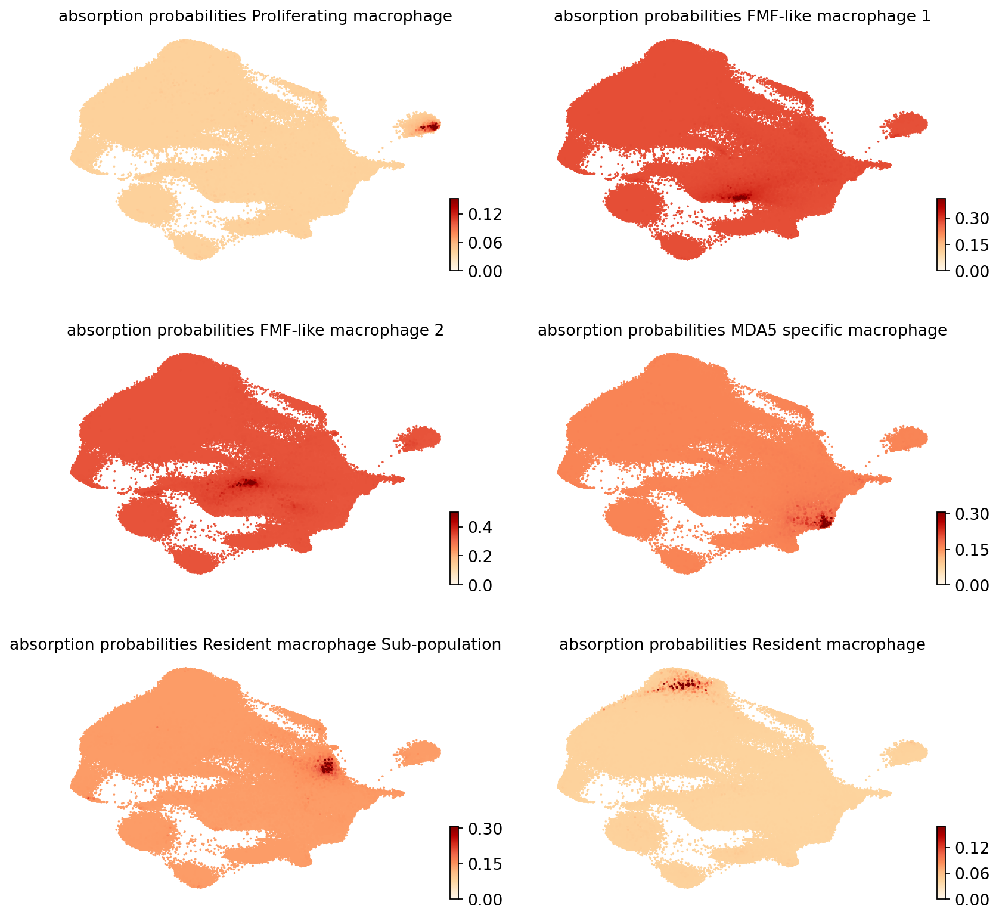

In [17]:
cr.tl.lineages(adata)
cr.pl.lineages(adata, same_plot=False,ncols=2,cmap='OrRd')

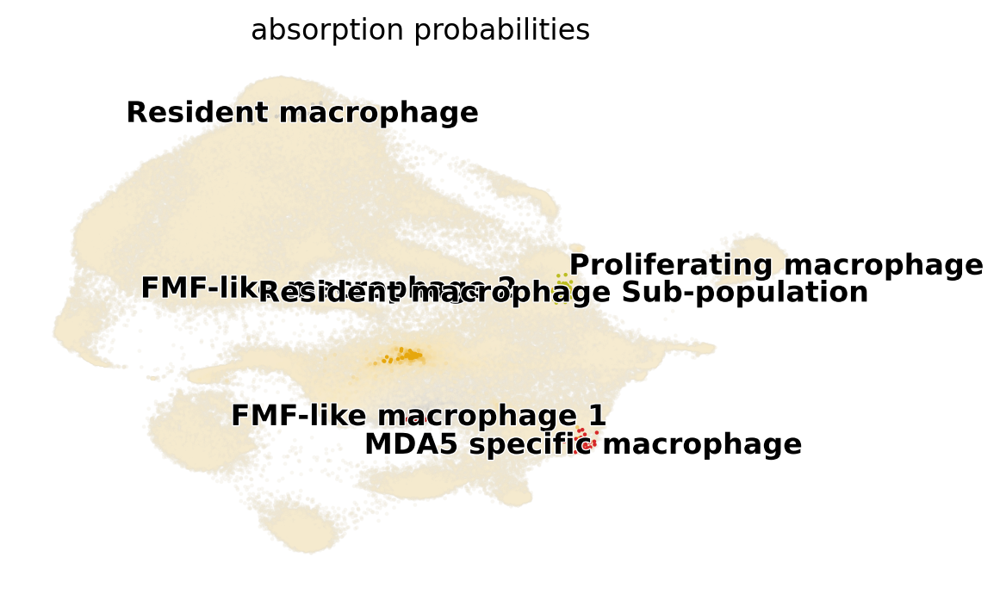

In [18]:
cr.pl.lineages(adata, discrete=True)

In [19]:
adata

AnnData object with n_obs × n_vars = 153706 × 10868
    obs: 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'Sample', 'batch', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'doublet_score', 'predicted_doublet', 'n_counts', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'log_counts', 'leiden', 'Cell_Type', 'leiden_resol_3', 'Defined_type', 'Monocyte_factors', 'CD14_binary', 'FCGR3A_binary', 'CCR2_binary', 'CX3CR1_binary', 'Tcell_factors', 'CD8A_binary', 'CD3E_binary', 'velocity_self_transition', 'terminal_states', 'terminal_states_probs', 'initial_states', 'initial_states_probs', 'clusters_gradients'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_coun

In [20]:
scv.tl.velocity_pseudotime(
    adata, root_key="initial_states_probs", end_key="terminal_states_probs"
)

/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()


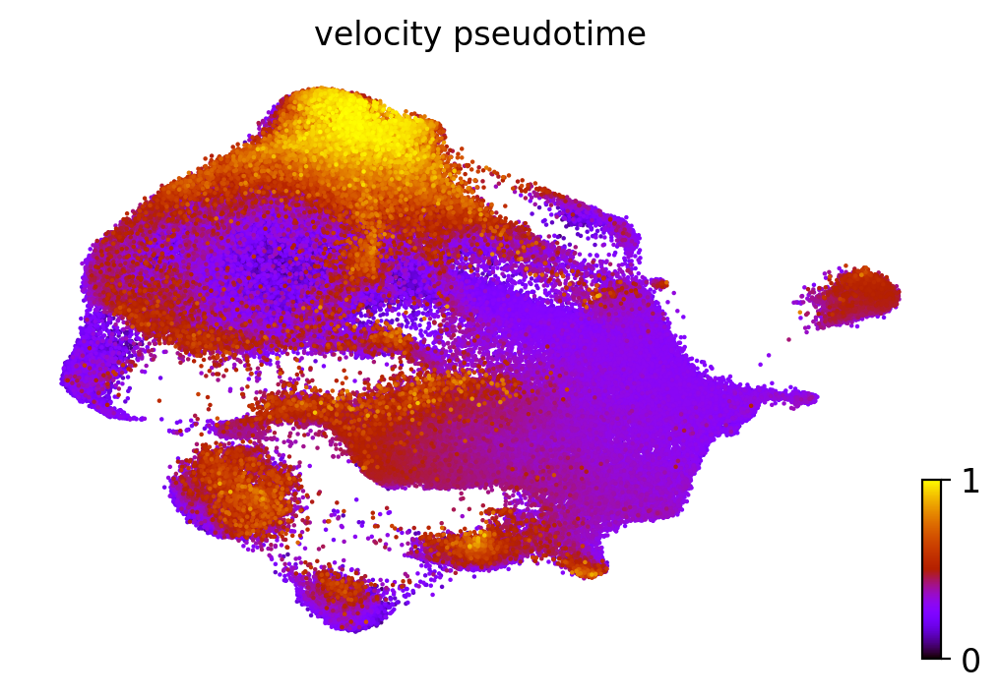

In [21]:
scv.pl.scatter(adata, color='velocity_pseudotime', color_map='gnuplot')

In [22]:
#scv.tl.recover_latent_time( adata, root_key="initial_states_probs", end_key="terminal_states_probs")

In [23]:
scv.tl.paga(
    adata,
    groups="Defined_type",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior='velocity_pseudotime',
)

running PAGA using priors: ['velocity_pseudotime', 'initial_states_probs', 'terminal_states_probs']
    finished (0:03:10) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


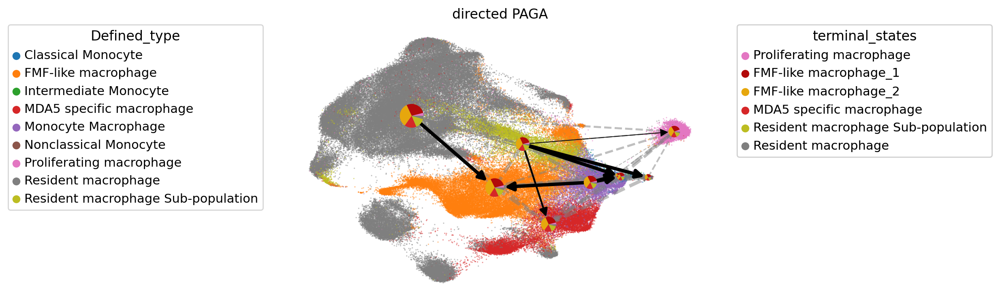

In [24]:
cr.pl.cluster_fates(
    adata,
    mode="paga_pie",
    cluster_key="Defined_type",
    basis="umap",
    legend_kwargs={"loc": "top right out"},
    legend_loc="top left out",
    node_size_scale=1,
    edge_width_scale=1,
    max_edge_width=3,
    title="directed PAGA",
)

In [25]:
adata.obs["Defined_type"].unique().tolist()

['MDA5 specific macrophage',
 'Resident macrophage',
 'FMF-like macrophage',
 'Proliferating macrophage',
 'Monocyte Macrophage',
 'Intermediate Monocyte',
 'Resident macrophage Sub-population',
 'Classical Monocyte',
 'Nonclassical Monocyte']

In [26]:
scv.tl.paga(
    adata,
    groups="leiden",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior="velocity_pseudotime",
)

running PAGA using priors: ['velocity_pseudotime', 'initial_states_probs', 'terminal_states_probs']
    finished (0:03:18) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


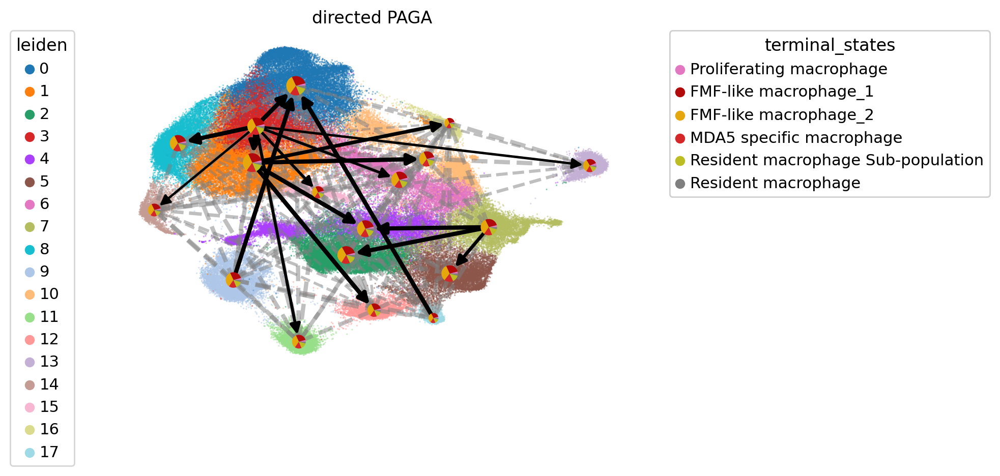

In [27]:
cr.pl.cluster_fates(
    adata,
    mode="paga_pie",
    cluster_key="leiden",
    basis="umap",
    legend_kwargs={"loc": "top right out"},
    legend_loc="top left out",
    node_size_scale=1,
    edge_width_scale=1,
    max_edge_width=3,
    title="directed PAGA",
)

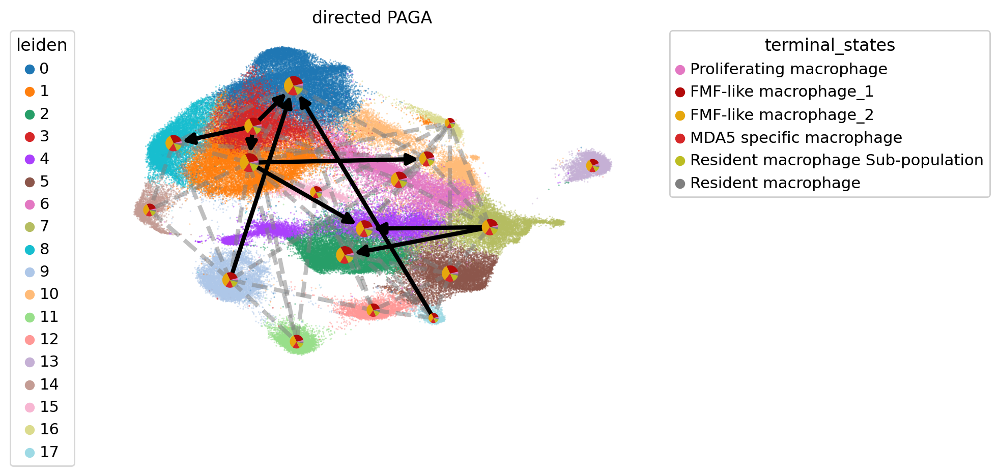

In [28]:
cr.pl.cluster_fates(
    adata,
    threshold=0.5,
    mode="paga_pie",
    cluster_key="leiden",
    basis="umap",
    legend_kwargs={"loc": "top right out"},
    legend_loc="top left out",
    node_size_scale=1,
    edge_width_scale=1,
    max_edge_width=3,
    title="directed PAGA",
)

In [29]:
cr.tl.lineage_drivers(adata)

/var/tmp/pbs.54523.idnfront2/ipykernel_1490179/1721556810.py:1: DeprecationWarning: `cellrank.tl.lineage_drivers` will be removed in version `2.0`. Please use the `cellrank.kernels` or `cellrank.estimators` interface instead.
  cr.tl.lineage_drivers(adata)


Adding `adata.varm['terminal_lineage_drivers']`
       `.lineage_drivers`
    Finish (0:00:37)


,Proliferating macrophage_corr,Proliferating macrophage_pval,Proliferating macrophage_qval,Proliferating macrophage_ci_low,Proliferating macrophage_ci_high,FMF-like macrophage_1_corr,FMF-like macrophage_1_pval,FMF-like macrophage_1_qval,FMF-like macrophage_1_ci_low,FMF-like macrophage_1_ci_high,...,Resident macrophage Sub-population_corr,Resident macrophage Sub-population_pval,Resident macrophage Sub-population_qval,Resident macrophage Sub-population_ci_low,Resident macrophage Sub-population_ci_high,Resident macrophage_corr,Resident macrophage_pval,Resident macrophage_qval,Resident macrophage_ci_low,Resident macrophage_ci_high
UBE2C,0.316085,0.000000e+00,NaN,0.311578,0.320578,-0.092653,1.480441e-290,NaN,-0.097607,-0.087694,...,-0.047374,4.107810e-77,NaN,-0.052361,-0.042385,-0.015590,9.804500e-10,NaN,-0.020588,-0.010592
TOP2A,0.281027,0.000000e+00,NaN,0.276416,0.285625,-0.078412,2.275626e-208,NaN,-0.083378,-0.073441,...,-0.042604,1.055430e-62,NaN,-0.047593,-0.037613,-0.015760,6.437167e-10,NaN,-0.020758,-0.010762
CDKN3,0.272748,0.000000e+00,NaN,0.268114,0.277369,-0.080325,1.331069e-218,NaN,-0.085290,-0.075356,...,-0.041800,2.005305e-60,NaN,-0.046789,-0.036808,-0.013031,3.237601e-07,NaN,-0.018029,-0.008032
CENPF,0.266312,0.000000e+00,NaN,0.261661,0.270951,-0.077863,1.766941e-205,NaN,-0.082830,-0.072892,...,-0.039949,2.408321e-55,NaN,-0.044940,-0.034957,-0.013902,5.017109e-08,NaN,-0.018900,-0.008904
MKI67,0.263914,0.000000e+00,NaN,0.259257,0.268559,-0.077184,6.190236e-202,NaN,-0.082152,-0.072213,...,-0.039211,2.207795e-53,NaN,-0.044202,-0.034219,-0.014666,8.915168e-09,NaN,-0.019664,-0.009667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
HSP90AB1,-0.043852,2.520718e-66,NaN,-0.048840,-0.038861,0.007698,2.542398e-03,NaN,0.002699,0.012697,...,-0.008148,1.401581e-03,NaN,-0.013146,-0.003148,-0.009639,1.572916e-04,NaN,-0.014638,-0.004640
TYMP,-0.054332,7.117953e-101,NaN,-0.059315,-0.049346,0.055822,2.184296e-106,NaN,0.050837,0.060805,...,-0.012588,8.001648e-07,NaN,-0.017586,-0.007589,-0.049766,6.472223e-85,NaN,-0.054752,-0.044778
SH3BGRL3,-0.060724,1.410840e-125,NaN,-0.065703,-0.055742,0.030007,5.714451e-32,NaN,0.025012,0.035001,...,0.038824,2.285437e-52,NaN,0.033831,0.043815,-0.031569,3.327186e-35,NaN,-0.036562,-0.026574
AC005740.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [30]:
Terminals = adata.obs['terminal_states'].unique().tolist()

In [31]:
Terminals.remove(np.NaN)

In [32]:
adata.varm['terminal_lineage_drivers']

,Proliferating macrophage_corr,Proliferating macrophage_pval,Proliferating macrophage_qval,Proliferating macrophage_ci_low,Proliferating macrophage_ci_high,FMF-like macrophage_1_corr,FMF-like macrophage_1_pval,FMF-like macrophage_1_qval,FMF-like macrophage_1_ci_low,FMF-like macrophage_1_ci_high,...,Resident macrophage Sub-population_corr,Resident macrophage Sub-population_pval,Resident macrophage Sub-population_qval,Resident macrophage Sub-population_ci_low,Resident macrophage Sub-population_ci_high,Resident macrophage_corr,Resident macrophage_pval,Resident macrophage_qval,Resident macrophage_ci_low,Resident macrophage_ci_high
ZNHIT1,0.007729,2.445119e-03,NaN,0.002729,0.012727,-0.005713,2.510850e-02,NaN,-0.010712,-0.000714,...,-0.001895,4.574314e-01,NaN,-0.006895,0.003104,0.008585,7.626161e-04,NaN,0.003586,0.013584
DTHD1,-0.001549,5.437903e-01,NaN,-0.006548,0.003451,-0.003728,1.438462e-01,NaN,-0.008727,0.001271,...,-0.000062,9.806080e-01,NaN,-0.005061,0.004937,-0.002467,3.334429e-01,NaN,-0.007466,0.002532
LATS1,-0.005218,4.077416e-02,NaN,-0.010217,-0.000219,0.010701,2.722724e-05,NaN,0.005702,0.015699,...,-0.004582,7.243860e-02,NaN,-0.009581,0.000417,-0.007355,3.930983e-03,NaN,-0.012354,-0.002356
ADAT1,0.004033,1.138236e-01,NaN,-0.000966,0.009032,0.002902,2.551904e-01,NaN,-0.002097,0.007901,...,-0.001136,6.561491e-01,NaN,-0.006135,0.003864,-0.000715,7.791031e-01,NaN,-0.005715,0.004284
GNG12-AS1,0.001046,6.818351e-01,NaN,-0.003954,0.006045,-0.000652,7.982862e-01,NaN,-0.005651,0.004347,...,-0.000232,9.275529e-01,NaN,-0.005231,0.004767,0.000311,9.029380e-01,NaN,-0.004688,0.005310
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
JOSD1,0.003464,1.744379e-01,NaN,-0.001535,0.008463,0.019095,7.046595e-14,NaN,0.014097,0.024092,...,-0.007178,4.887769e-03,NaN,-0.012177,-0.002179,-0.009308,2.628239e-04,NaN,-0.014307,-0.004309
TCF19,0.121085,0.000000e+00,NaN,0.116156,0.126008,-0.037227,2.746328e-48,NaN,-0.042218,-0.032234,...,-0.018616,2.891739e-13,NaN,-0.023613,-0.013618,-0.004165,1.024712e-01,NaN,-0.009164,0.000834
CCDC102B,-0.001552,5.429004e-01,NaN,-0.006551,0.003447,0.000496,8.456819e-01,NaN,-0.004503,0.005496,...,-0.000395,8.767783e-01,NaN,-0.005395,0.004604,-0.001515,5.526388e-01,NaN,-0.006514,0.003485
F11R,0.013079,2.929599e-07,NaN,0.008080,0.018077,-0.028545,4.358472e-29,NaN,-0.033539,-0.023549,...,-0.001534,5.475006e-01,NaN,-0.006533,0.003465,0.016487,1.017019e-10,NaN,0.011489,0.021485


In [33]:
adata

AnnData object with n_obs × n_vars = 153706 × 10868
    obs: 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'Sample', 'batch', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'doublet_score', 'predicted_doublet', 'n_counts', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'log_counts', 'leiden', 'Cell_Type', 'leiden_resol_3', 'Defined_type', 'Monocyte_factors', 'CD14_binary', 'FCGR3A_binary', 'CCR2_binary', 'CX3CR1_binary', 'Tcell_factors', 'CD8A_binary', 'CD3E_binary', 'velocity_self_transition', 'terminal_states', 'terminal_states_probs', 'initial_states', 'initial_states_probs', 'clusters_gradients', 'velocity_pseudotime'
    var: 'gene_ids', 'feature_types', 'genome', 'Accession', 'Chromosome', 'End', 'Start', 'Strand', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_

In [34]:
#adata.write(out_path+'/human_subset_0607.h5ad')

/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDeprecationWarning: The draw_all function was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use fig.draw_without_rendering() instead.
  cb.draw_all()
/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/scvelo/plotting/utils.py:869: MatplotlibDepreca

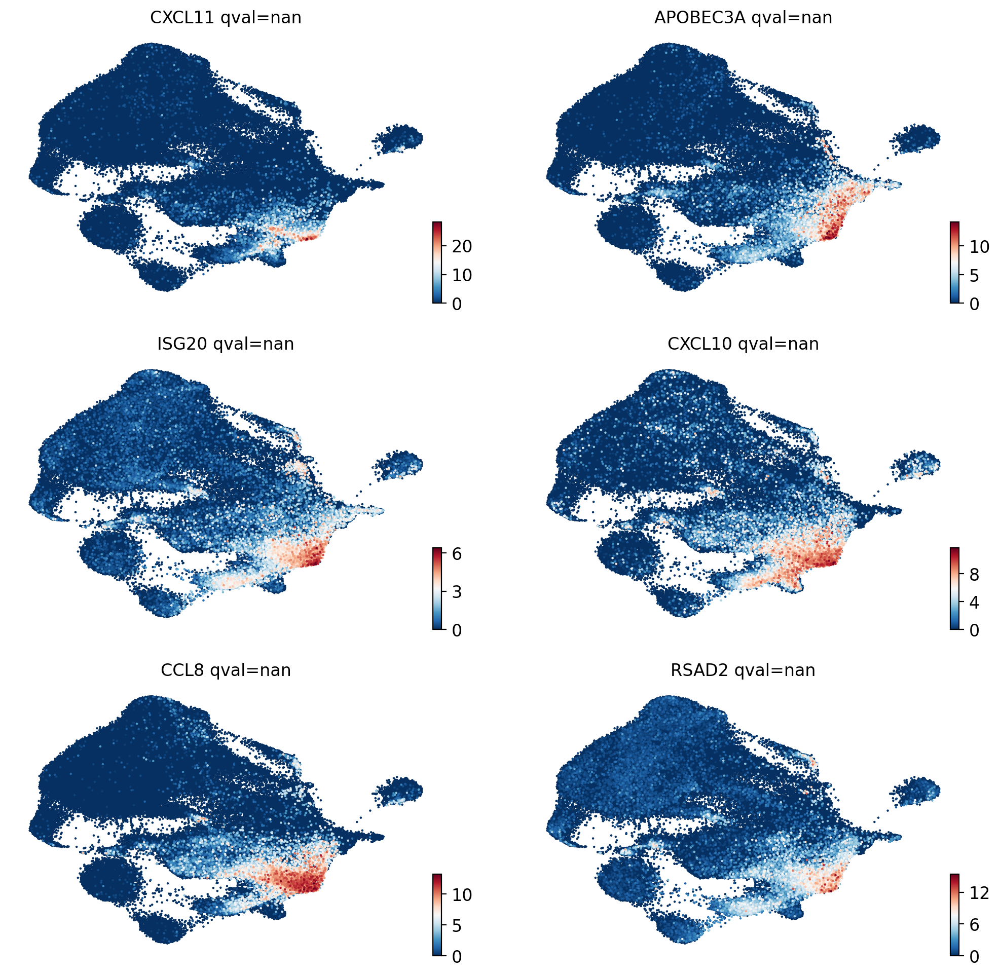

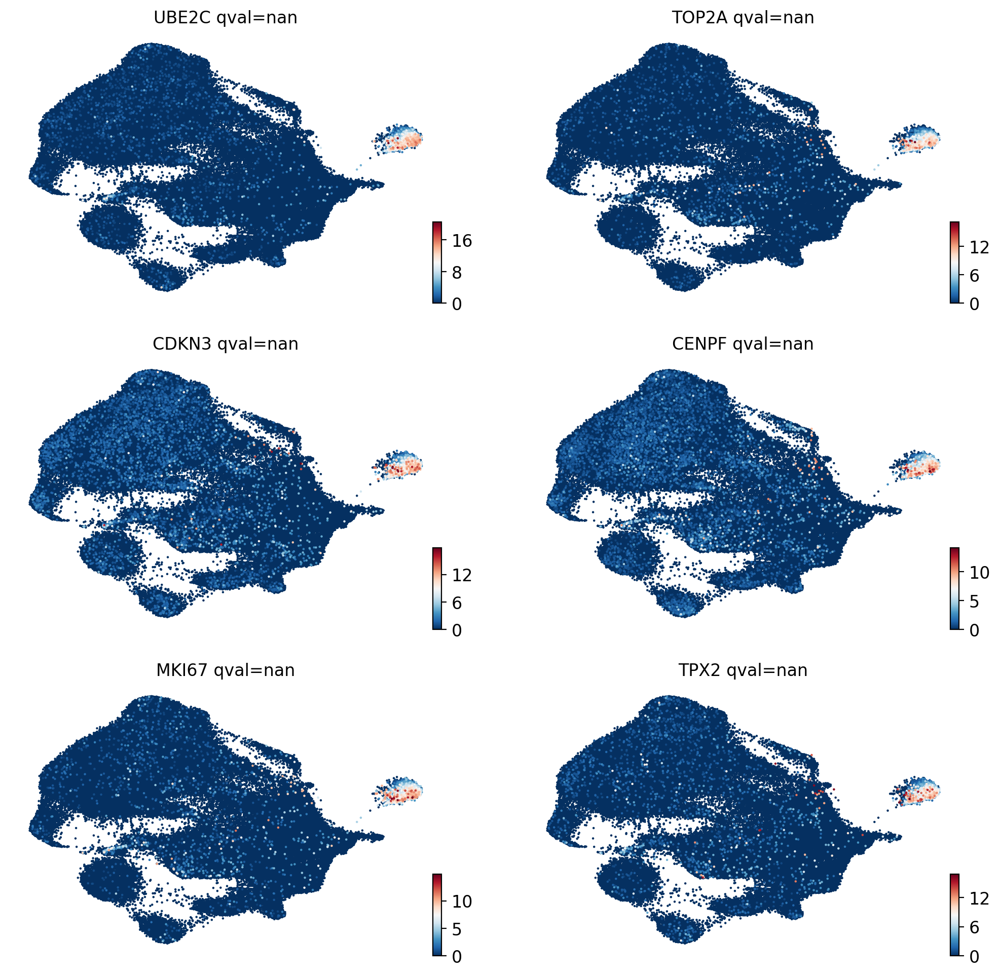

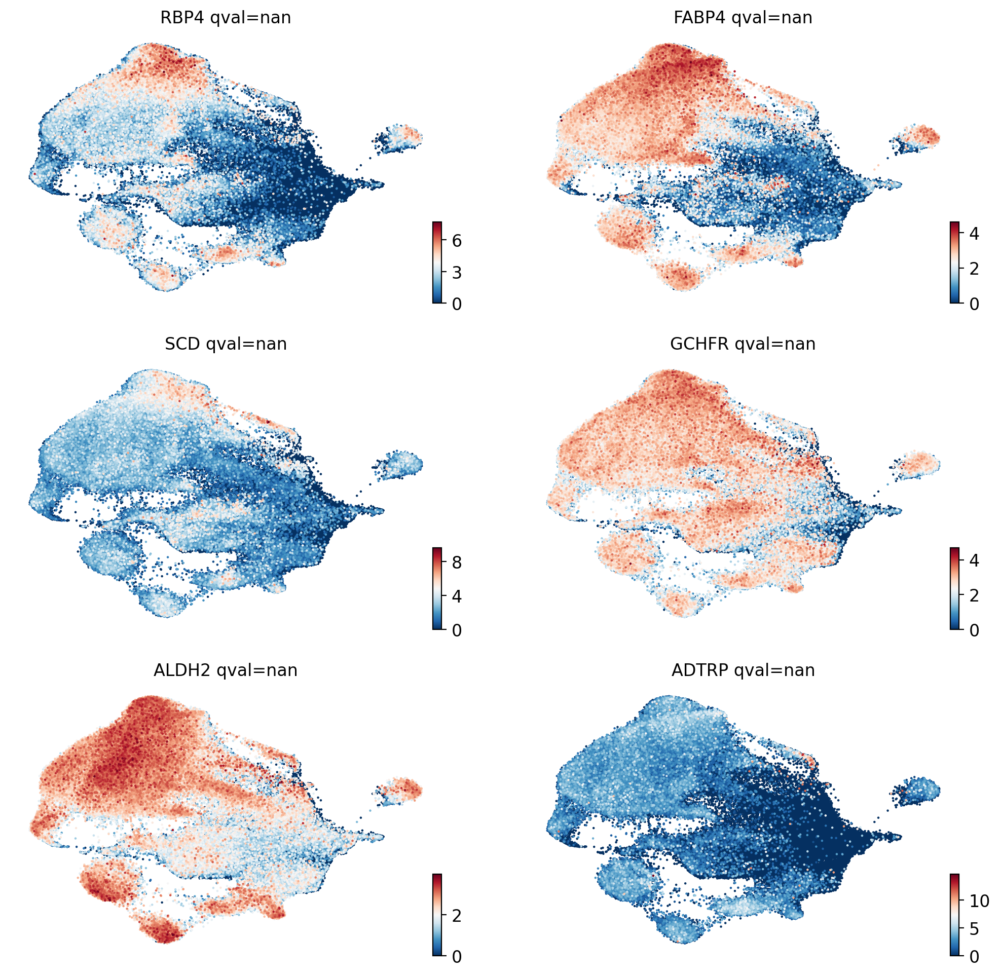

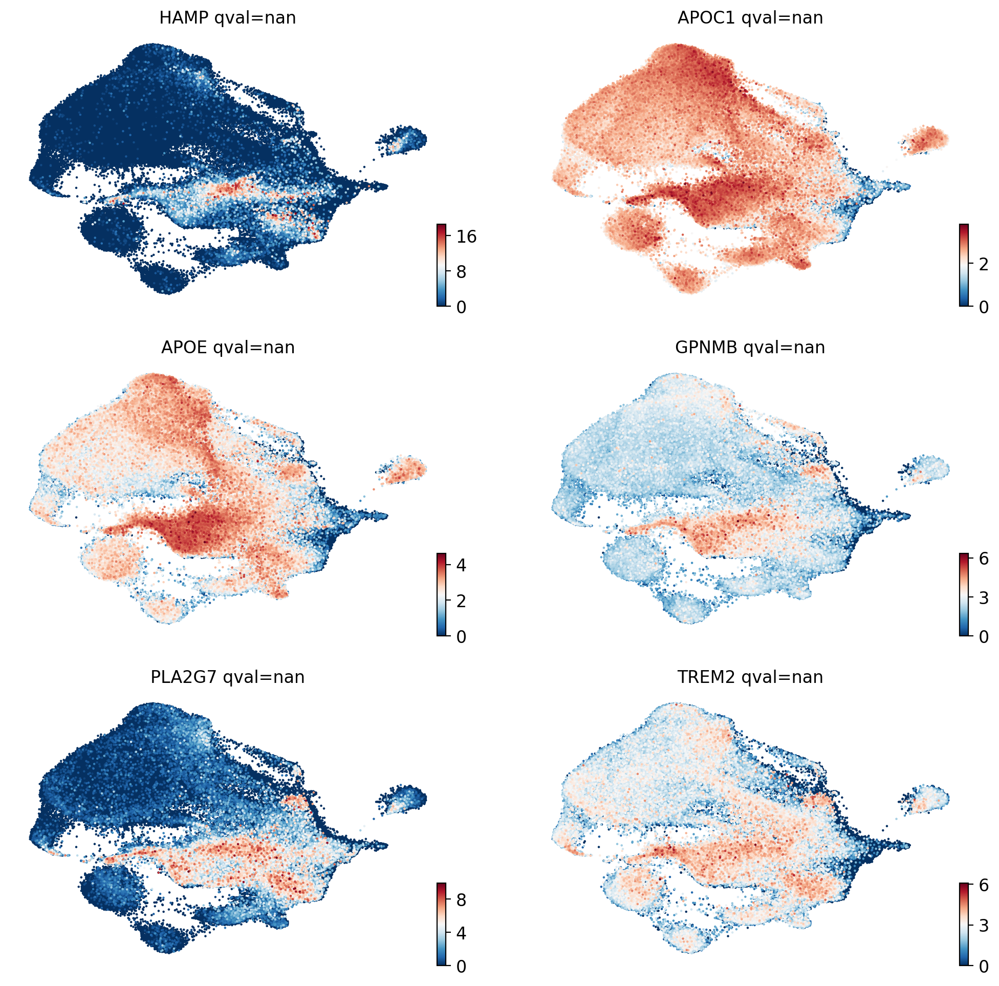

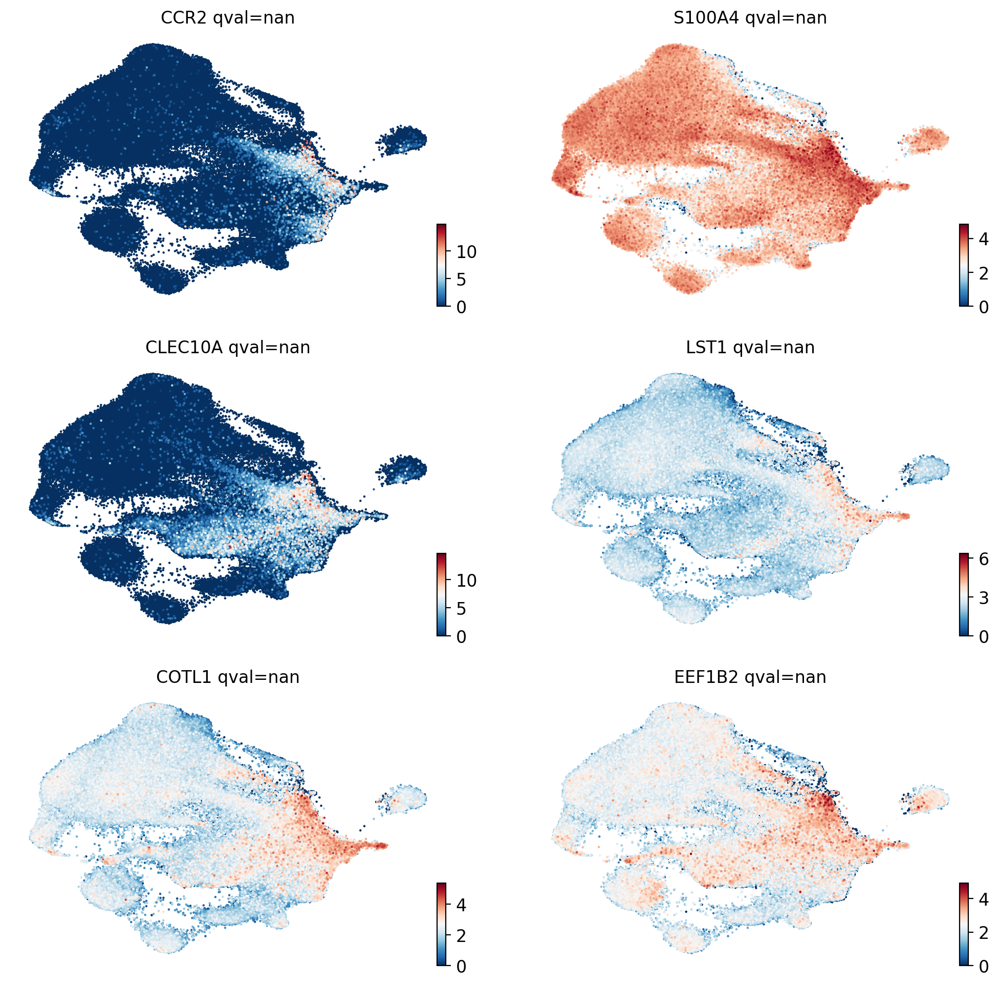

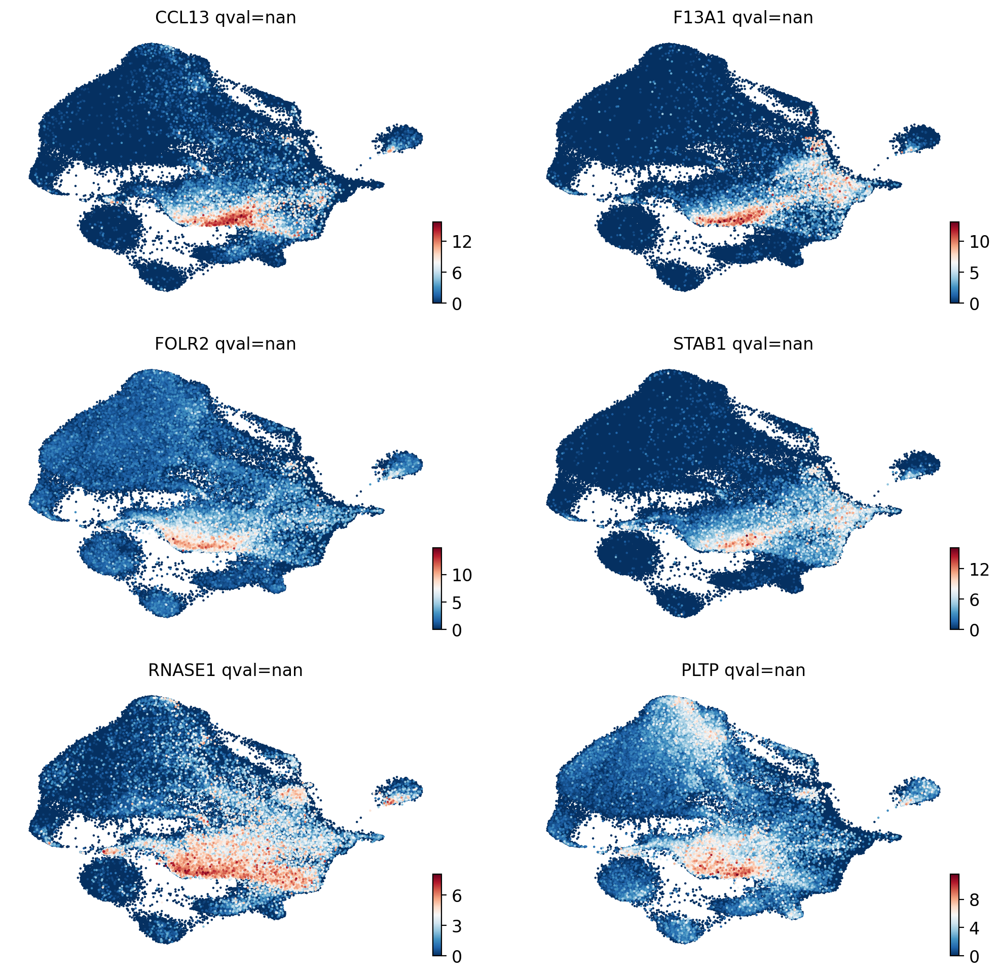

In [35]:
for te in Terminals:
    cr.pl.lineage_drivers(adata, lineage=te, n_genes=6,ncols=2)

In [36]:
Terminals = adata.obs['terminal_states'].unique().tolist()
Terminals.remove(np.nan)
top_drivers = {}
for te in Terminals:
    top_drivers[te]=adata.varm['terminal_lineage_drivers'][te+"_corr"].sort_values(ascending=False).index[:200]
top_200 = pd.DataFrame(top_drivers)
top_200.to_csv(out_path+'/Macrophage_remove_PBMC_DC_drivers.csv')

In [37]:
Terminals = adata.obs['terminal_states'].unique().tolist()
Terminals.remove(np.nan)
top3_drivers = []
for te in Terminals:
    top3_drivers.extend(adata.varm['terminal_lineage_drivers'][te+"_corr"].sort_values(ascending=False).index[:1])


In [38]:
top3_drivers

['CXCL11', 'UBE2C', 'RBP4', 'HAMP', 'CCR2', 'CCL13']

Computing trends using `1` core(s)


  0%|                                                   | 0/6 [00:00<?, ?gene/s]/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/pygam/utils.py:649: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  bases = (x >= aug_knots[:-1]).astype(np.int) * \
/user/ifrec/liuyuchen/anaconda3/envs/cellrank/lib/python3.8/site-packages/pygam/utils.py:650: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `

    Finish (0:01:12)
Plotting trends


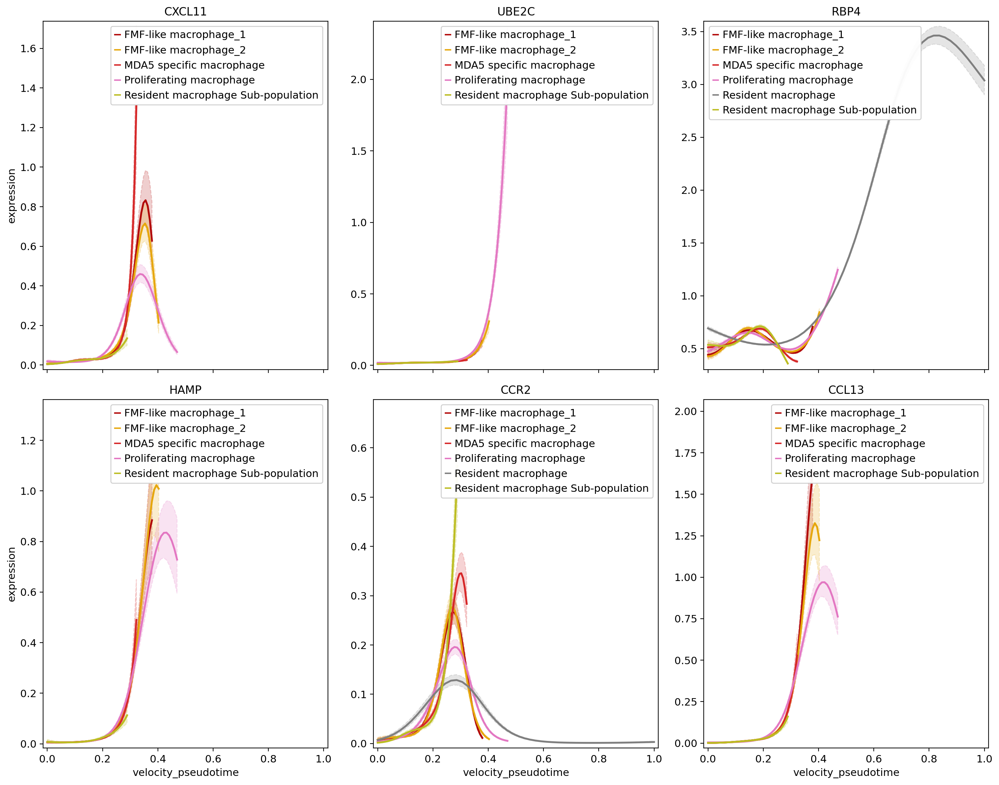

In [39]:
model = cr.ul.models.GAM(adata)
cr.pl.gene_trends(
    adata,
    model=model,
    data_key="X",
    genes=top3_drivers,
    ncols=3,
    time_key="velocity_pseudotime",
    same_plot=True,
    hide_cells=True,
    figsize=(15, 12),
    n_test_points=50,
)

In [40]:

from pyBCS import scanpy2bcs
scanpy2bcs.format_data(out_path+'/human_subset_remove_PBMC_DC.h5ad', out_path+'/human_subset_remove_PBMC_DC.bcs',
                        input_format="h5ad", graph_based="leiden")


ModuleNotFoundError: No module named 'pyBCS'